In [1]:
import cv2
import datetime as dt
import numpy as np
import matplotlib.pyplot as plt
import os
import pandas as pd
import tensorflow as tf
import tensorflow_datasets as tfds

from IPython.display import clear_output
from numba import cuda
from sklearn.model_selection import train_test_split
#from tensorflow_examples.models.pix2pix import pix2pix
from tensorflow.keras.callbacks import EarlyStopping, TensorBoard
from tensorflow.keras.layers import Input, Conv2D, Conv2DTranspose, \
                                    MaxPooling2D, BatchNormalization, Dropout, concatenate 
from tensorflow.keras.models import Model
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.preprocessing import timeseries_dataset_from_array, image
from tensorflow.keras.utils import plot_model
#from tqdm.notebook import tqdm

# Load the TensorBoard notebook extension
%load_ext tensorboard
%matplotlib inline

In [2]:
!nvidia-smi

Tue Feb 28 03:15:50 2023       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 517.00       Driver Version: 517.00       CUDA Version: 11.7     |
|-------------------------------+----------------------+----------------------+
| GPU  Name            TCC/WDDM | Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  NVIDIA GeForce ... WDDM  | 00000000:06:00.0 Off |                  N/A |
| N/A   49C    P0    N/A /  N/A |      0MiB /  2048MiB |      3%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [3]:
tf.random.set_seed(43)

In [4]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]

In [5]:
gpu_options = tf.compat.v1.GPUOptions(per_process_gpu_memory_fraction=0.5)
sess = tf.compat.v1.Session(config=tf.compat.v1.ConfigProto(gpu_options=gpu_options))

In [6]:
tf.config.set_soft_device_placement(True)

In [7]:
# Paths to our images and masks folders
PATH_images = 'D:\Data\Study\segmentation_full_body_mads_dataset_1192_img\images' 
PATH_masks = 'D:\Data\Study\segmentation_full_body_mads_dataset_1192_img\masks'
img = os.listdir(PATH_images)
msk = os.listdir(PATH_masks)
arr_col = 1
LENGHT = 800

In [8]:
images = []
masks = []
image_size = (128, 128)
for name in img:
    images.append(image.load_img(PATH_images + '/' + name, target_size = image_size))
    masks.append(image.load_img(PATH_masks + '/' + name, color_mode = 'grayscale', target_size = image_size))

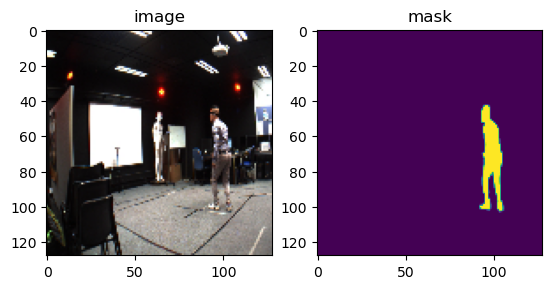

In [9]:
fig = plt.figure()

ax_1 = fig.add_subplot(1, 2, 1)
ax_2 = fig.add_subplot(1, 2, 2)
ax_1.set(title = 'image')
ax_2.set(title = 'mask')

ax_1.imshow(images[34])
ax_2.imshow(masks[34])

plt.show()

In [10]:
x_train_test = []
for img in images:
    x_train_test.append(image.img_to_array(img)/255)
x_train_test = np.array(x_train_test)
x_train_test = x_train_test[:LENGHT]
print(x_train_test.shape)

(800, 128, 128, 3)


In [11]:
y_train_test = []
for mask in masks:
    y_train_test.append(image.img_to_array(mask)/255)
y_train_test = np.array(y_train_test)
y_train_test = y_train_test[:LENGHT]
print(y_train_test.shape)

(800, 128, 128, 1)


In [12]:
num_examples=int(LENGHT * 0.7)
num_examples

560

In [13]:
y_train = y_train_test[:num_examples,:,:,:]
X_train = x_train_test[:num_examples,:,:,:]
y_test = y_train_test[num_examples:,:,:,:]
X_test = x_train_test[num_examples:,:,:,:]
y_train.shape, X_train.shape, y_test.shape, X_test.shape

((560, 128, 128, 1),
 (560, 128, 128, 3),
 (240, 128, 128, 1),
 (240, 128, 128, 3))

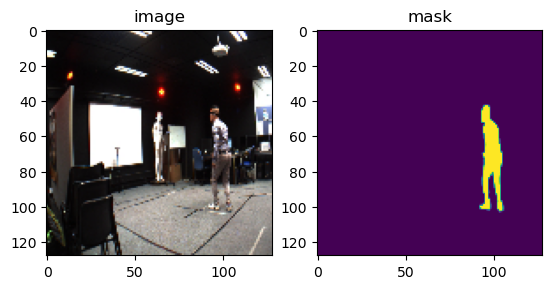

In [14]:
n=10

fig = plt.figure()

ax_1 = fig.add_subplot(1, 2, 1)
ax_2 = fig.add_subplot(1, 2, 2)
ax_1.set(title = 'image')
ax_2.set(title = 'mask')

ax_1.imshow(image.array_to_img(X_train[34]))
ax_2.imshow(y_train[34])

plt.show()

In [15]:
X_train.shape[1:]

(128, 128, 3)

In [16]:
pre_trained_model = tf.keras.applications.vgg16.VGG16(
    include_top=False,
    weights='imagenet',
    input_shape=X_train.shape[1:])

In [17]:
pre_trained_model.summary()

Model: "vgg16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 32, 32, 128)       0     

In [18]:
def dice_coef(y_true, y_pred):
    return (2. * tf.math.reduce_sum(y_true * y_pred) + 1.) / (tf.math.reduce_sum(y_true) + tf.math.reduce_sum(y_pred))

def unet_pre_train(
    num_classes=1, 
    input_shape=(128, 128, 3), 
    pre_trained_model = None):
    for layer in pre_trained_model.layers[:-5]:
        layer.trainable = False

    x = pre_trained_model.layers[13].output
    block_4_out = pre_trained_model.layers[10].output
    block_3_out = pre_trained_model.layers[6].output
    block_2_out = pre_trained_model.layers[3].output
    block_1_out = pre_trained_model.layers[1].output
    img_input = pre_trained_model.inputs

   
    # UP 1
    #x = concatenate([x, block_4_out])
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(256, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)

    # UP 2
    x = Conv2DTranspose(256, (2, 2), activation='relu', strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    #x = concatenate([x, block_3_out])
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(128, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)

    # UP 3
    x = Conv2DTranspose(128, (2, 2), activation='relu', strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)

    #x = concatenate([x, block_2_out])
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    x = Conv2D(64, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)

    # UP 4
    x = Conv2DTranspose(64, (2, 2), activation='relu', strides=(2, 2), padding='same')(x)
    x = BatchNormalization()(x)
    
    #x = concatenate([x, block_1_out])
    x = Conv2D(32, (3, 3), activation='relu', padding='same')(x)
    x = BatchNormalization()(x)
    
    x = Conv2D(num_classes, (3, 3), activation='sigmoid', padding='same')(x)

    model = Model(img_input, x)
    return model

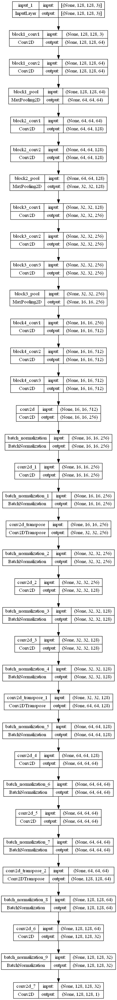

In [19]:
model_Unet = unet_pre_train(num_classes=1, input_shape=(128, 128, 3), pre_trained_model = pre_trained_model)
plot_model(model_Unet, to_file='model_Unet.png', show_shapes=True)

In [20]:
model_Unet.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_1 (InputLayer)        [(None, 128, 128, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 128, 128, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 128, 128, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 64, 64, 64)        0         
                                                                 
 block2_conv1 (Conv2D)       (None, 64, 64, 128)       73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 64, 64, 128)       147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 32, 32, 128)       0     

In [21]:
model_Unet.compile(optimizer='adam',
                   loss='binary_crossentropy',
                   metrics=[dice_coef])

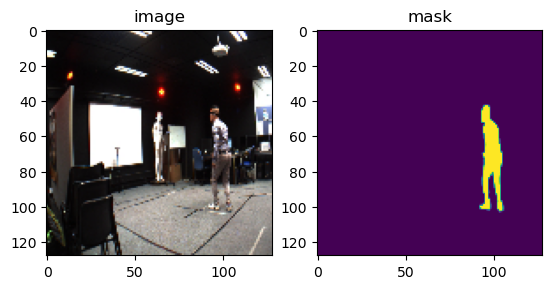

In [22]:
n=10

fig = plt.figure()

ax_1 = fig.add_subplot(1, 2, 1)
ax_2 = fig.add_subplot(1, 2, 2)
ax_1.set(title = 'image')
ax_2.set(title = 'mask')

ax_1.imshow(image.array_to_img(X_train[34]))
ax_2.imshow(y_train[34])

plt.show()

In [23]:
class DisplayCallback(tf.keras.callbacks.Callback):
    def on_epoch_end(self, epoch, logs = None):
        clear_output(wait=True)
        y_pred = self.model(X_train[:1])
        fig = plt.figure(figsize=(16, 4))

        ax_1 = fig.add_subplot(1, 4, 1)
        ax_2 = fig.add_subplot(1, 4, 2)
        ax_3 = fig.add_subplot(1, 4, 3)
        ax_4 = fig.add_subplot(1, 4, 4)
        ax_1.set(title = 'image')
        ax_2.set(title = 'true_mask')
        ax_3.set(title = 'pred_mask')
        ax_4.set(title = 'segment_image')

        ax_1.imshow(image.array_to_img(X_train[0]))
        ax_2.imshow(y_train[0])
        ax_3.imshow(y_pred[0])
        ax_4.imshow(image.array_to_img(y_pred[0]*X_train[0]))
        
        plt.savefig(f'model_Unet_fit_epoch_{epoch}.png')

        plt.show()
        
        print(f'\nSample prediction after epoch {epoch+1}\n')
        

In [24]:
logdir = os.path.join('unet_log', dt.datetime.now().strftime('%Y%m%d-%H%M%S'))
tensorboard_callback = TensorBoard(logdir, histogram_freq=1)
callback = EarlyStopping(monitor='val_dice_coef', patience=10)

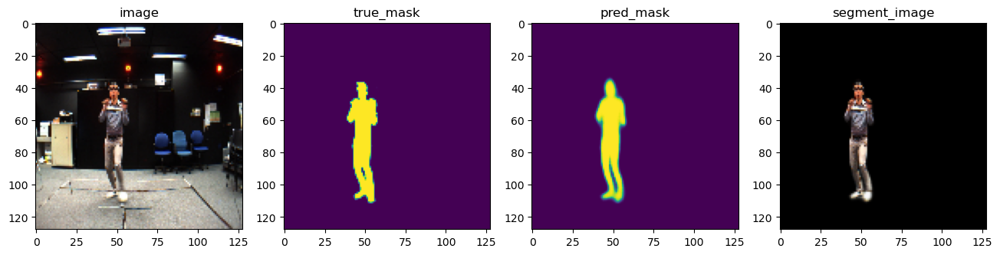


Sample prediction after epoch 20

112/112 [==============================] - 29s 260ms/step - loss: 0.0132 - dice_coef: 0.8883 - val_loss: 0.0814 - val_dice_coef: 0.6788


In [25]:
EPOCHS = 20
BATCH_SIZE = 5
model_history = model_Unet.fit(X_train, y_train, epochs=EPOCHS,
                               batch_size=BATCH_SIZE,
                               validation_data=(X_test, y_test),
                               callbacks=[DisplayCallback(), tensorboard_callback]) # ,callback 

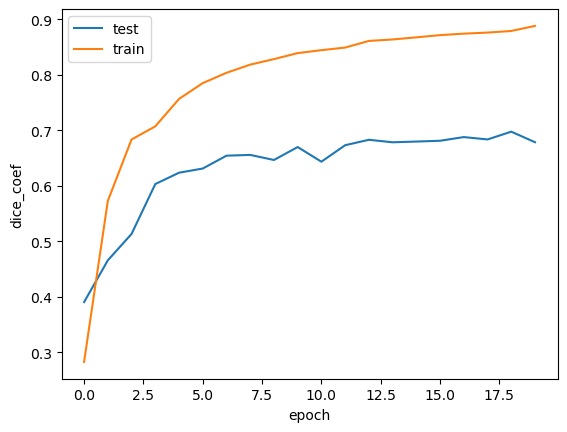

In [26]:
plt.plot(model_history.history['val_dice_coef'], label='test')
plt.plot(model_history.history['dice_coef'], label='train')
plt.legend()
plt.xlabel('epoch')
plt.ylabel('dice_coef')
plt.show()

In [27]:
model_Unet.save('my_Unet_model.h5')

In [28]:
# device = cuda.get_current_device()
# device.reset()

In [29]:
y_pred = model_Unet.predict(X_test[:100])
print(y_pred.shape)

4/4 [==============================] - 16s 1s/step
(100, 128, 128, 1)


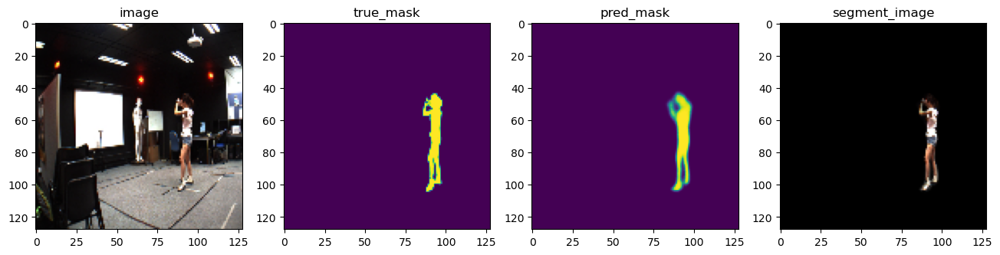

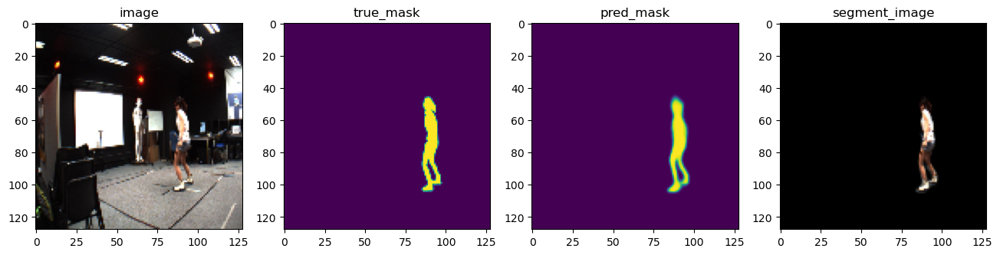

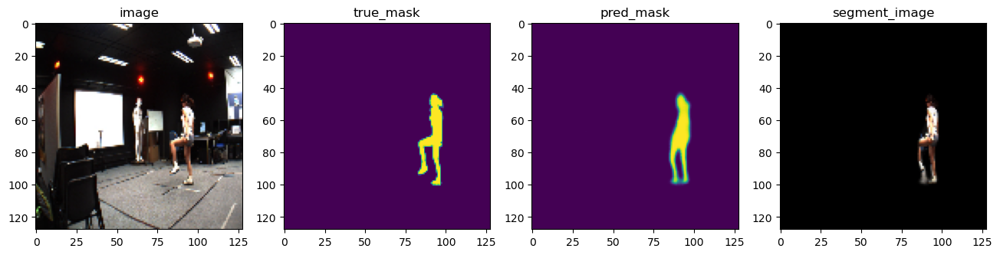

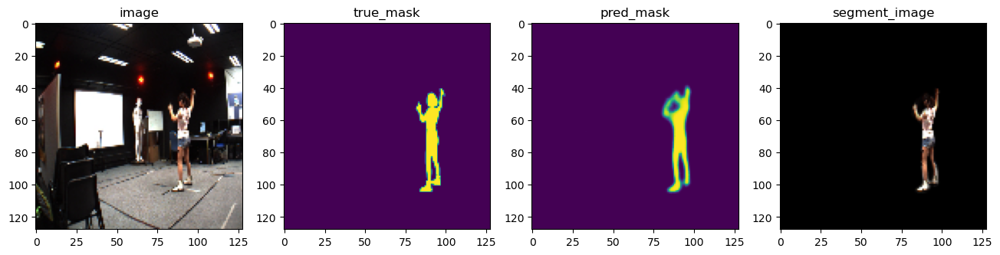

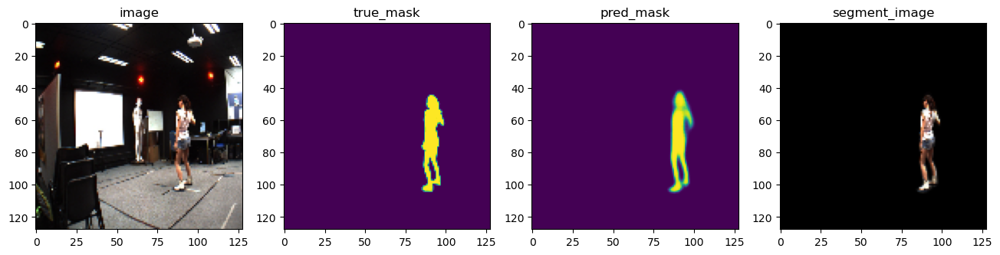

...

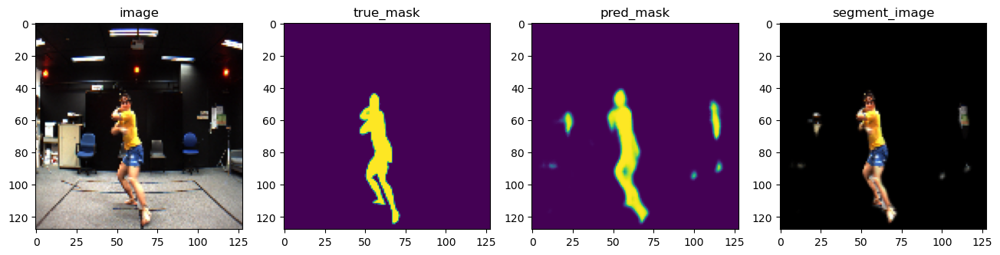

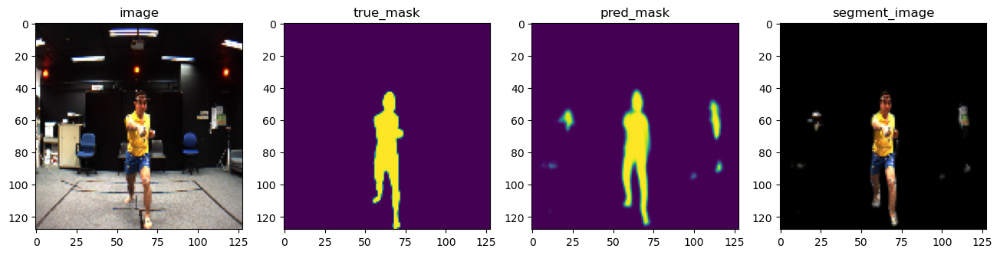

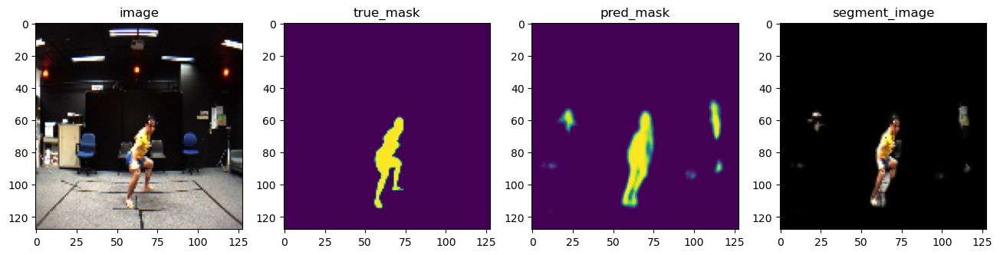

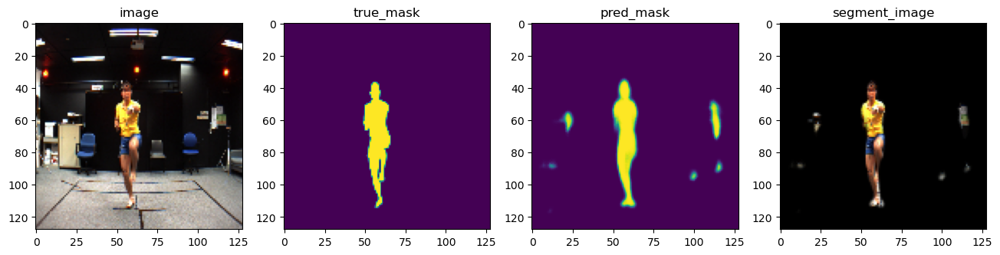

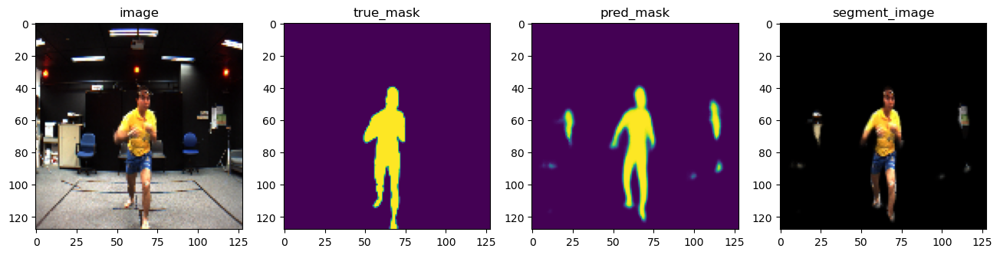

In [32]:
for i in range(100):
    fig = plt.figure(figsize=(16, 4))

    ax_1 = fig.add_subplot(1, 4, 1)
    ax_2 = fig.add_subplot(1, 4, 2)
    ax_3 = fig.add_subplot(1, 4, 3)
    ax_4 = fig.add_subplot(1, 4, 4)
    ax_1.set(title = 'image')
    ax_2.set(title = 'true_mask')
    ax_3.set(title = 'pred_mask')
    ax_4.set(title = 'segment_image')

    ax_1.imshow(image.array_to_img(X_test[i]))
    ax_2.imshow(y_test[i])
    ax_3.imshow(y_pred[i])
    ax_4.imshow(image.array_to_img(y_pred[i]*X_test[i]))

    plt.show()

In [34]:
#cuda.close()

In [33]:
%tensorboard --logdir unet_log --bind_all

### Чем проще модель тем лучше показатели :)